# Melbourne Data Visualization
## Gunakan Dataset Melbourne Housing Market (FULL)
- Bersihkan data
- Lakukan visualisasi data dengan apa yang sudah dipelajari
    - lineplot = [All-year Mean Price Per Season, All-year House Sold Per Season]
    - scatter = [House Sold by each type, house sold by season]
    - barplot = [mean price per seller, house sold per seller, mean price per region name, house sold per region, mean price per method, house sold per method, All-time 10 best Real Estate (Seller) Total Sales]
    - boxplot = [house price based on type per season]
    - piechart = [house sold in 2016 per season, house sold in 2017 per season, house sold in 2018 per season, Overal Sales per season]
    
- dari kolom ['date']
    - buat kolom baru ['month_sold'] = [1-12]
    - buat kolom baru ['year_sold'] = [2016-2018]
    - buat kolom baru ['season_sold'] = isinya ['spring', 'summer', 'autumn', 'winter']
    - menggunakan pie chart tentukan musim mana yang penjualan rumahnya, paling banyak dari tahun ke tahun.
    
- buatlah tampilan scatter seperti berikut:
<img src="From Tutor\soal_melb.jpg">

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import datetime as dt
from scipy.stats import mode 

In [3]:
mel=pd.read_csv('Intro to pandas\Melbourne_housing_FULL.csv')
mel.head()

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,68 Studley St,2,h,NaN,SS,Jellis,3/09/2016,2.5,3067.0,...,1.0,1.0,126.0,NaN,NaN,Yarra City Council,-37.8014,144.9958,Northern Metropolitan,4019.0
1,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,...,1.0,1.0,202.0,NaN,NaN,Yarra City Council,-37.7996,144.9984,Northern Metropolitan,4019.0
2,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,...,1.0,0.0,156.0,79.0,1900.0,Yarra City Council,-37.8079,144.9934,Northern Metropolitan,4019.0
3,Abbotsford,18/659 Victoria St,3,u,NaN,VB,Rounds,4/02/2016,2.5,3067.0,...,2.0,1.0,0.0,NaN,NaN,Yarra City Council,-37.8114,145.0116,Northern Metropolitan,4019.0
4,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,...,2.0,0.0,134.0,150.0,1900.0,Yarra City Council,-37.8093,144.9944,Northern Metropolitan,4019.0


In [4]:
mel['ys']=mel['Date']
mel['ms']=mel['Date']
mel['ss']=mel['Date']
for i in range(len(mel['Date'])):
    mel['ys'][i]=mel['Date'][i][-4:]
    mel['ms'][i]=mel['Date'][i][-7:-5]
mel['ys']=pd.to_numeric(mel['ys'])
mel['ms']=pd.to_numeric(mel['ms'])

In [5]:
for i in range(len(mel['ms'])):
    if mel['ms'][i]>=3 and mel['ms'][i]<=5:
        mel['ss'][i]='Spring'
    elif mel['ms'][i]>=6 and mel['ms'][i]<=8:
        mel['ss'][i]='Summer'
    elif mel['ms'][i]>=9 and mel['ms'][i]<=11:
        mel['ss'][i]='Fall'
    elif mel['ms'][i]==12 or mel['ms'][i]>=1 and mel['ms'][i]<=2:
        mel['ss'][i]='Winter'

In [6]:
mel.dropna(subset=['Price', 'Lattitude','Longtitude'],inplace=True)

In [7]:
mel.isna().sum()

Suburb               0
Address              0
Rooms                0
Type                 0
Price                0
Method               0
SellerG              0
Date                 0
Distance             0
Postcode             0
Bedroom2           209
Bathroom           215
Car                592
Landsize          3033
BuildingArea     10346
YearBuilt         8917
CouncilArea          0
Lattitude            0
Longtitude           0
Regionname           0
Propertycount        0
ys                   0
ms                   0
ss                   0
dtype: int64

In [8]:
mel.drop('BuildingArea',axis=1,inplace=True)

In [9]:
mode_room=[]
for i in ['Bedroom2','Bathroom','Car','Landsize','YearBuilt']:
    mode_room.append(mel[mel[i].isna()==True]['Rooms'].mode()[0])
mode_df=pd.DataFrame(mode_room,index=['Bedroom2','Bathroom','Car','Landsize','YearBuilt'],columns=['mode_rooms'])
mode_df

,mode_rooms
Bedroom2,3
Bathroom,3
Car,3
Landsize,3
YearBuilt,3


In [10]:
value_mode=[]
for i in ['Bedroom2','Bathroom','Car','Landsize','YearBuilt']:
    value_mode.append(mel[mel['Rooms']==mode_df.mean()[0]][i].mode()[0])
mode_df['value_mode']=value_mode
mode_df

,mode_rooms,value_mode
Bedroom2,3,3.0
Bathroom,3,1.0
Car,3,2.0
Landsize,3,0.0
YearBuilt,3,1960.0


In [11]:
na_column=['Bedroom2','Bathroom','Car','Landsize','YearBuilt']
for i in range(len(na_column)):
    mel[na_column[i]].fillna(mode_df['value_mode'][i],inplace=True)

## Data Visualization

In [12]:
mel_byS=mel.groupby('ss')
mel_byY=mel.groupby('ys')
mel_bySeller=mel.groupby('SellerG')
mel_byRegion=mel.groupby('Regionname')
mel_byMethod=mel.groupby('Method')
mel_byType=mel.groupby('Type')

In [13]:
display(mel_byS.mean())
display(mel_byY.mean())
display(mel_bySeller.mean())
display(mel_byRegion.mean())
display(mel_byMethod.mean())
display(mel_byType.mean())

,Rooms,Price,Distance,Postcode,Bedroom2,Bathroom,Car,Landsize,YearBuilt,Lattitude,Longtitude,Propertycount,ys,ms
ss,,,,,,,,,,,,,,
Fall,3.119256,1.118454e+06,11.674740,3117.163430,3.111187,1.612965,1.786379,430.453911,1963.340263,-37.807153,144.997520,7565.738786,2016.641822,9.914934
Spring,2.982270,1.111639e+06,9.893262,3101.864831,2.959741,1.544222,1.619107,545.591781,1961.997080,-37.804451,144.989751,7484.539841,2016.971214,4.056738
Summer,2.990723,1.025743e+06,11.565367,3116.677890,2.971139,1.555918,1.663632,581.239306,1965.631507,-37.811078,145.003824,7496.971826,2016.672393,7.020787
Winter,3.166014,1.108565e+06,12.506164,3124.666341,3.166014,1.638943,1.848989,494.875082,1964.183301,-37.802627,144.992161,7487.842466,2017.275277,5.537182


,Rooms,Price,Distance,Postcode,Bedroom2,Bathroom,Car,Landsize,YearBuilt,Lattitude,Longtitude,Propertycount,ms
ys,,,,,,,,,,,,,
2016,2.841957,1.072413e+06,8.552743,3095.884790,2.798656,1.499140,1.528998,427.053306,1960.479600,-37.809181,144.987243,7500.111615,8.279662
2017,3.109577,1.090398e+06,12.271162,3120.702138,3.109077,1.603711,1.774108,543.040852,1965.298860,-37.808359,145.001976,7509.117314,7.573342
2018,3.363213,1.129731e+06,14.070974,3132.849825,3.363989,1.712844,1.968568,545.230501,1964.986418,-37.794944,144.995658,7593.662786,2.251455


,Rooms,Price,Distance,Postcode,Bedroom2,Bathroom,Car,Landsize,YearBuilt,Lattitude,Longtitude,Propertycount,ys,ms
SellerG,,,,,,,,,,,,,,
@Realty,3.666667,8.723333e+05,17.216667,3084.166667,3.666667,1.833333,2.000000,752.666667,1969.166667,-37.707992,145.012678,10126.5000,2017.333333,6.333333
ASL,3.600000,1.227100e+06,12.080000,3086.200000,3.600000,1.800000,1.600000,510.000000,1970.200000,-37.747146,145.055228,10859.0000,2016.400000,9.400000
Abercromby's,3.200000,2.048600e+06,6.112000,3143.080000,3.320000,2.040000,1.960000,398.000000,1957.960000,-37.847148,145.021294,10132.0800,2016.680000,6.440000
Ace,2.500000,6.287500e+05,15.075000,3031.500000,2.500000,1.250000,2.500000,463.250000,1968.000000,-37.798905,144.799535,4728.5000,2017.250000,6.500000
Alex,3.000000,1.100000e+06,35.200000,3806.000000,3.000000,2.000000,2.000000,1212.000000,1960.000000,-38.035170,145.365640,17093.0000,2017.000000,10.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
hockingstuart/hockingstuart,3.166667,8.497500e+05,27.483333,3196.166667,3.166667,1.500000,2.666667,397.500000,1965.833333,-38.055142,145.129157,3641.0000,2017.000000,10.666667
iOne,3.000000,6.200000e+05,7.000000,3013.000000,3.000000,3.000000,1.000000,0.000000,2014.000000,-37.819400,144.882600,6543.0000,2016.000000,4.000000
iProperty,3.000000,8.200000e+05,17.200000,3133.000000,3.000000,2.000000,2.000000,277.000000,2016.000000,-37.835810,145.198020,4181.0000,2017.000000,6.000000


,Rooms,Price,Distance,Postcode,Bedroom2,Bathroom,Car,Landsize,YearBuilt,Lattitude,Longtitude,Propertycount,ys,ms
Regionname,,,,,,,,,,,,,,
Eastern Metropolitan,3.413213,1.135330e+06,14.622948,3115.938624,3.411650,1.757232,1.872557,563.752932,1967.044957,-37.795507,145.143885,6122.536357,2016.954261,7.266224
Eastern Victoria,3.524823,7.213474e+05,34.146099,3529.411348,3.524823,1.851064,2.063830,1838.652482,1974.595745,-37.950048,145.327712,9366.765957,2017.226950,7.120567
Northern Metropolitan,2.884866,9.034460e+05,9.361221,3085.986818,2.872351,1.426831,1.578175,480.744535,1962.881195,-37.734296,144.983797,9356.858668,2016.814951,7.057734
Northern Victoria,3.492958,6.193099e+05,33.164085,3455.711268,3.485915,1.880282,2.140845,3361.161972,1981.795775,-37.594166,144.853591,4561.978873,2017.323944,6.795775
South-Eastern Metropolitan,3.347911,9.025066e+05,24.475219,3231.485909,3.349854,1.674441,2.015549,490.965015,1969.500486,-37.999847,145.149218,6895.650146,2017.159378,7.337221
Southern Metropolitan,2.966667,1.464194e+06,8.914860,3157.766667,2.951869,1.665265,1.674766,460.112773,1959.819626,-37.869790,145.035432,7559.336760,2016.677570,7.184891
Western Metropolitan,3.119645,8.657166e+05,10.882756,3037.736261,3.096495,1.549978,1.801601,453.792514,1966.349416,-37.781588,144.846738,6079.917568,2016.830593,7.054522
Western Victoria,3.386364,4.399631e+05,30.797727,3337.750000,3.375000,1.443182,2.056818,539.250000,1973.625000,-37.696684,144.567506,4154.568182,2017.193182,7.443182


,Rooms,Price,Distance,Postcode,Bedroom2,Bathroom,Car,Landsize,YearBuilt,Lattitude,Longtitude,Propertycount,ys,ms
Method,,,,,,,,,,,,,,
PI,3.198847,1.171344e+06,10.363771,3109.250309,3.182791,1.734870,1.814327,550.175793,1963.671058,-37.812421,145.005547,7716.274599,2016.802388,7.078221
S,3.046948,1.083416e+06,11.705345,3116.203709,3.031907,1.550015,1.710499,482.875073,1963.398949,-37.805108,144.997409,7558.737661,2016.808703,7.151285
SA,3.087838,1.015492e+06,14.379730,3140.756757,3.081081,1.581081,1.844595,862.513514,1970.182432,-37.832925,145.026740,7649.371622,2016.986486,7.094595
SP,2.947309,9.237125e+05,11.890807,3112.587070,2.946188,1.520553,1.686099,434.898356,1966.568012,-37.802162,144.974214,7296.311286,2016.833333,7.144993
VB,3.119374,1.257943e+06,9.306213,3111.271037,3.103718,1.728474,1.740705,695.916341,1962.472114,-37.817310,145.008815,7277.312133,2016.866928,7.086106


,Rooms,Price,Distance,Postcode,Bedroom2,Bathroom,Car,Landsize,YearBuilt,Lattitude,Longtitude,Propertycount,ys,ms
Type,,,,,,,,,,,,,,
h,3.321429,1.211649e+06,12.258938,3116.091340,3.299494,1.651707,1.862137,558.389191,1959.482301,-37.801710,144.996236,7384.972250,2016.886030,7.152212
t,2.879052,9.560366e+05,10.243017,3106.437656,2.860349,1.825436,1.604115,231.678304,1985.491272,-37.819801,144.999227,7210.448878,2016.761222,6.989401
u,1.977585,6.094885e+05,7.871589,3111.840011,2.004483,1.182684,1.161390,408.629308,1973.142897,-37.824477,144.997687,8238.538246,2016.542169,7.125806


## Visualisasi Data

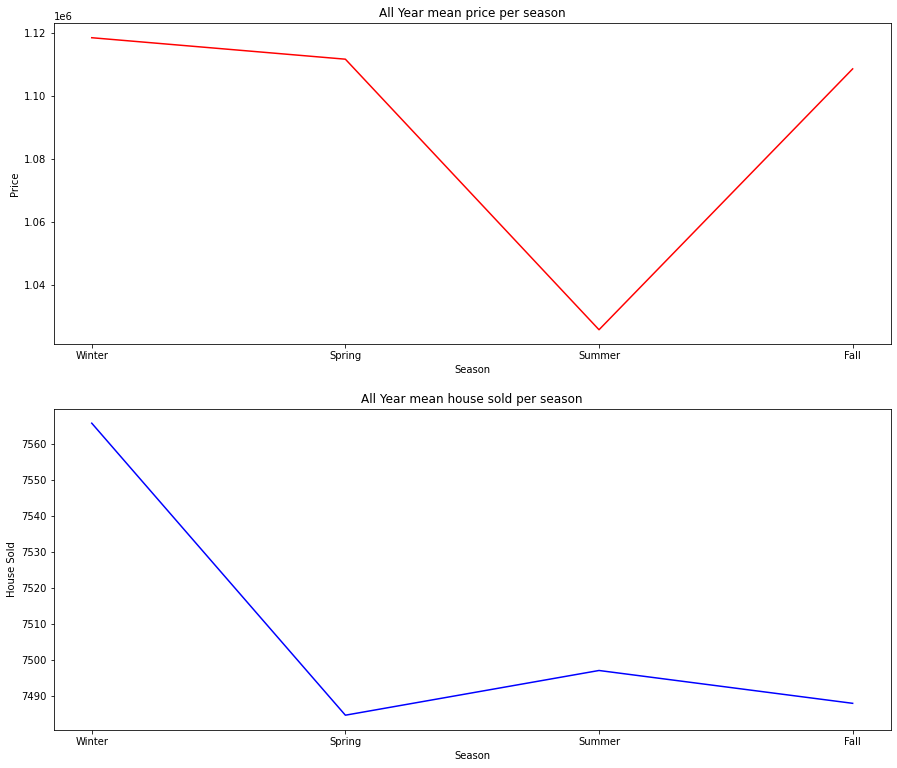

In [14]:
x=mel['ss'].unique()
y=mel_byS.mean()['Price']
y1=mel_byS.mean()['Propertycount']
plt.figure(figsize=(15,13))

plt.subplot(2,1,1)
plt.title('All Year mean price per season')
plt.xlabel('Season')
plt.ylabel('Price')
plt.plot(x,y,'red')

plt.subplot(2,1,2)
plt.title('All Year mean house sold per season')
plt.xlabel('Season')
plt.ylabel('House Sold')
plt.plot(x,y1,'blue')

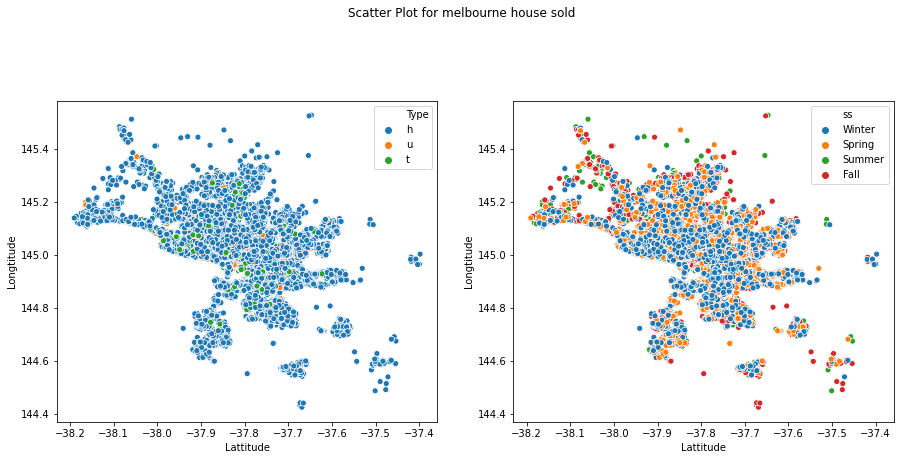

In [15]:
x=mel['Lattitude']
y=mel['Longtitude']
plt.figure(figsize=(15,13))
plt.suptitle('Scatter Plot for melbourne house sold')

plt.subplot(2,2,1)
sns.scatterplot(x,y,hue=mel['Type'])

plt.subplot(2,2,2)
sns.scatterplot(x,y,hue=mel['ss'])

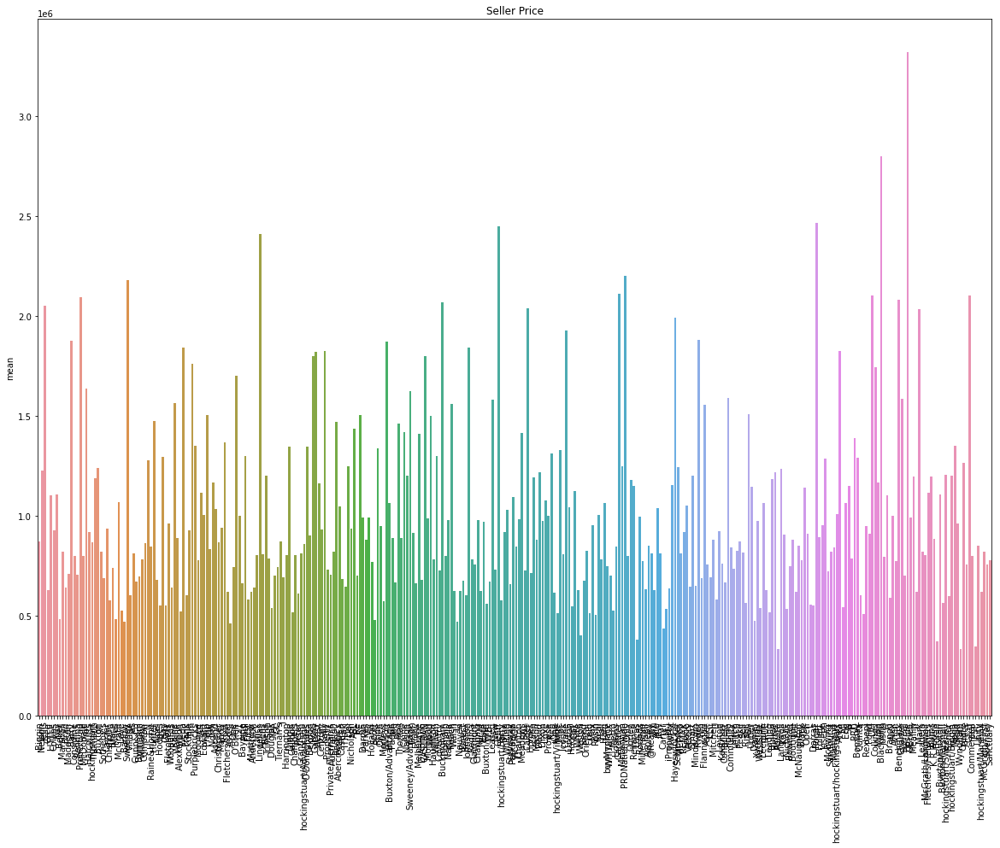

In [43]:
plt.figure(figsize=(20,15))
# plt.suptitle('Barplot for seller, region, and best 10 seller')

# plt.subplot(3,2,1)
plt.title('Seller Price')
plt.xticks(rotation=90)
sns.barplot(x=mel['SellerG'].unique(),y=mel_bySeller.describe()['Price']['mean'])

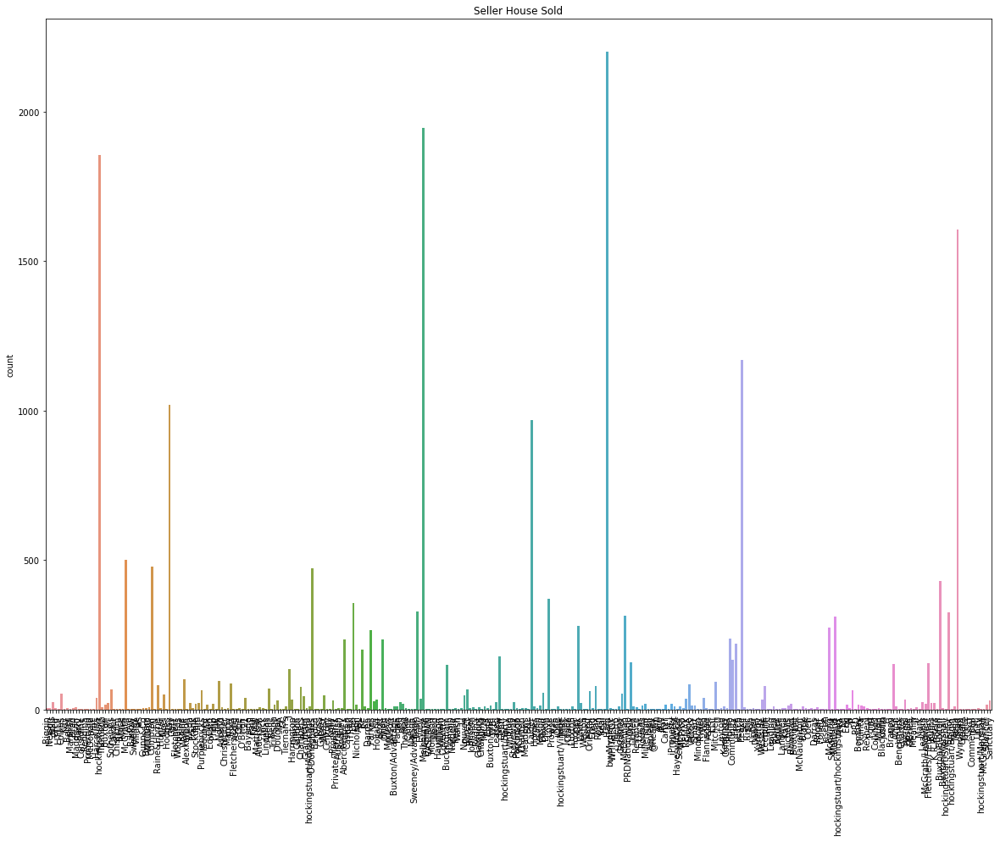

In [42]:
# plt.subplot(3,2,2)
plt.figure(figsize=(20,15))
plt.title('Seller House Sold')
plt.xticks(rotation=90)
sns.barplot(x=mel['SellerG'].unique(),y=mel_bySeller.describe()['Price']['count'])

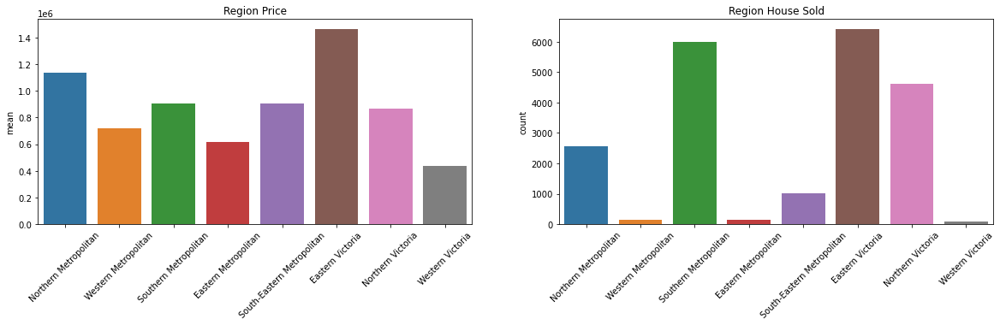

In [44]:
plt.figure(figsize=(20,15))
plt.subplot(3,2,3)
plt.title('Region Price')
plt.xticks(rotation=45)
sns.barplot(x=mel['Regionname'].unique(),y=mel_byRegion.describe()['Price']['mean'])

plt.subplot(3,2,4)
plt.title('Region House Sold')
plt.xticks(rotation=45)
sns.barplot(x=mel['Regionname'].unique(),y=mel_byRegion.describe()['Price']['count'])

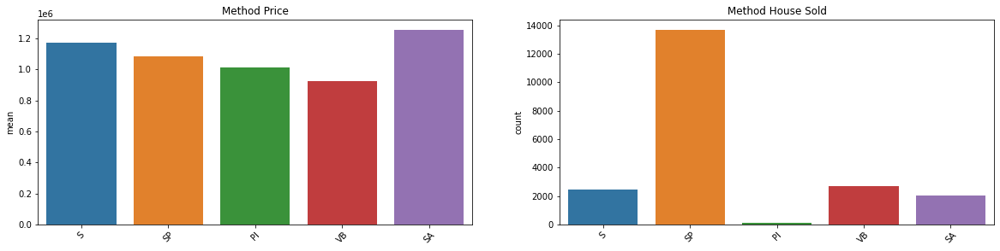

In [36]:
plt.figure(figsize=(20,15))
plt.subplot(3,2,3)
plt.title('Method Price')
plt.xticks(rotation=45)
sns.barplot(x=mel['Method'].unique(),y=mel_byMethod.describe()['Price']['mean'])

plt.subplot(3,2,4)
plt.title('Method House Sold')
plt.xticks(rotation=45)
sns.barplot(x=mel['Method'].unique(),y=mel_byMethod.describe()['Price']['count'])

In [20]:
top10=mel_bySeller.describe()["Price"].sort_values(['count','mean'],ascending=False).head(10)
top10

,count,mean,std,min,25%,50%,75%,max
SellerG,,,,,,,,
Nelson,2201.0,1.065185e+06,4.818838e+05,170000.0,746500.0,975000.0,1300000.0,4011000.0
Jellis,1947.0,1.408149e+06,7.270669e+05,145000.0,902000.0,1305000.0,1750000.0,6600000.0
Barry,1856.0,8.685148e+05,3.536495e+05,222000.0,630000.0,780500.0,1020500.0,3700000.0
hockingstuart,1606.0,9.620269e+05,5.813436e+05,185000.0,591375.0,810000.0,1223750.0,11200000.0
Ray,1171.0,8.687092e+05,3.806479e+05,240000.0,603500.0,791000.0,1050000.0,2718000.0
Buxton,1018.0,1.294953e+06,5.730518e+05,240000.0,897500.0,1216000.0,1600000.0,5150000.0
Marshall,968.0,2.036744e+06,1.035127e+06,280000.0,1384750.0,1893000.0,2500000.0,6800000.0
Biggin,501.0,1.067698e+06,5.838197e+05,145000.0,670000.0,940000.0,1300000.0,4250000.0
Brad,479.0,8.612937e+05,3.732663e+05,216000.0,622500.0,806000.0,1006500.0,2650000.0


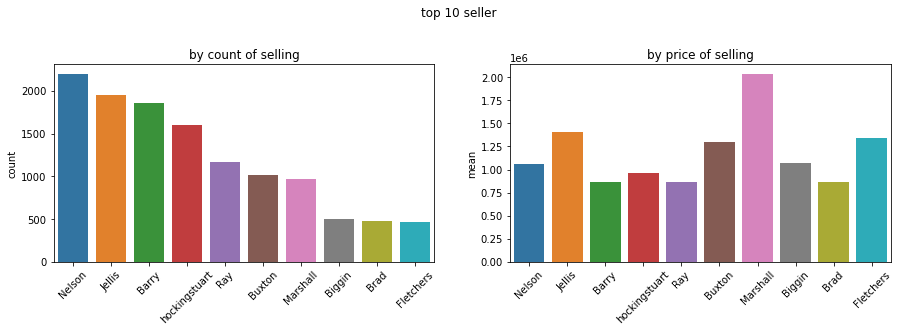

In [21]:
plt.figure(figsize=(15,8))
plt.suptitle('top 10 seller')

plt.subplot(2,2,1)
plt.title('by count of selling')
plt.xticks(rotation=45)
sns.barplot(x=top10.index.tolist(),y=top10['count'])

plt.subplot(2,2,2)
plt.title('by price of selling')
plt.xticks(rotation=45)
sns.barplot(x=top10.index.tolist(),y=top10['mean'])


## Boxplot

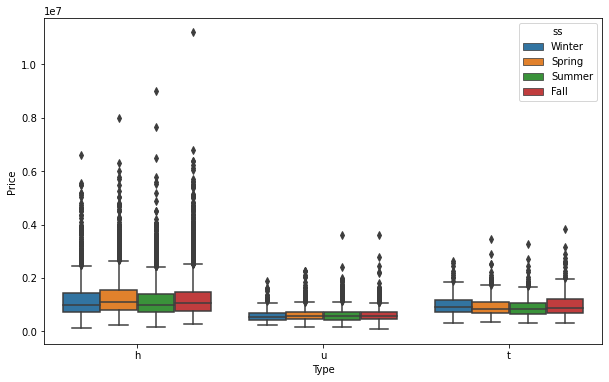

In [22]:
plt.figure(figsize=(10,6))
sns.boxplot(x='Type',y='Price',hue='ss',data=mel)


## Pie Chart

In [40]:
sales_2016=mel[mel['ys']==2016]['ss'].value_counts()
sales_2017=mel[mel['ys']==2017]['ss'].value_counts()
sales_2018=mel[mel['ys']==2018]['ss'].value_counts()
sales=mel['ss'].value_counts()

([<matplotlib.patches.Wedge at 0x1f408d7a070>,
 [Text(-0.9774365275569529, 0.5045967049014553, 'Fall'),
  Text(-0.09010777621525289, -1.096303146335694, 'Summer'),
  Text(1.0977286068187424, -0.07065342009969017, 'Spring'),
  Text(0.4871850712984185, 0.9862305543350172, 'Winter')],
 [Text(-0.5331471968492469, 0.27523456630988463, '34.8'),
  Text(-0.04914969611741066, -0.5979835343649239, '27.7'),
  Text(0.5987610582647684, -0.03853822914528554, '22.8'),
  Text(0.2657373116173191, 0.5379439387281911, '14.6')])

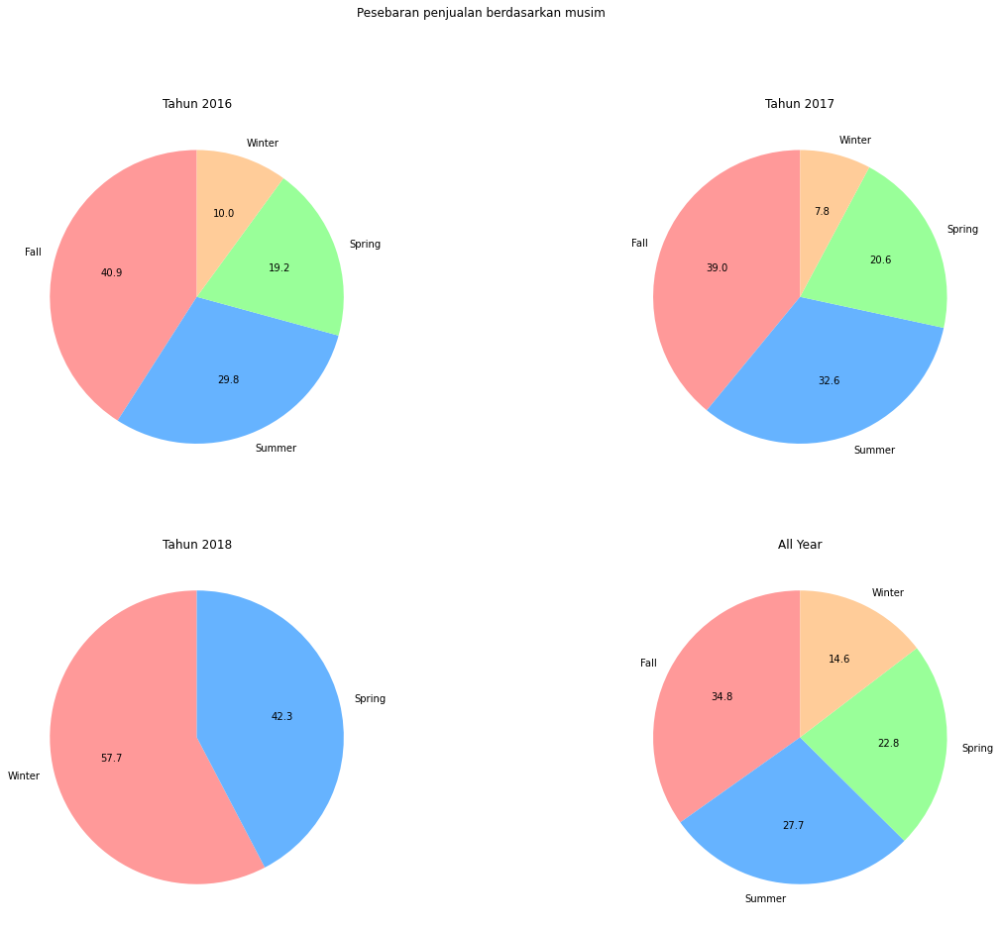

In [41]:
color=['#ff9999','#66b3ff','#99ff99','#ffcc99']
plt.figure(figsize=(20,15))
plt.suptitle('Pesebaran penjualan berdasarkan musim')

plt.subplot(2,2,1)
plt.title('Tahun 2016')
plt.pie(sales_2016,labels=sales_2016.index.tolist(),colors=color,autopct='%.1f', startangle=90)

plt.subplot(2,2,2)
plt.title('Tahun 2017')
plt.pie(sales_2017,labels=sales_2017.index.tolist(),colors=color,autopct='%.1f', startangle=90)

plt.subplot(2,2,3)
plt.title('Tahun 2018')
plt.pie(sales_2018,labels=sales_2018.index.tolist(),colors=color,autopct='%.1f', startangle=90)

plt.subplot(2,2,4)
plt.title('All Year')
plt.pie(sales,labels=sales.index.tolist(),colors=color,autopct='%.1f', startangle=90)


## End of Task Melbourne

## Setuju/Tidak jika kedekatan properti dengan CBD mempengaruhi harga
## Buktikan dengan data!

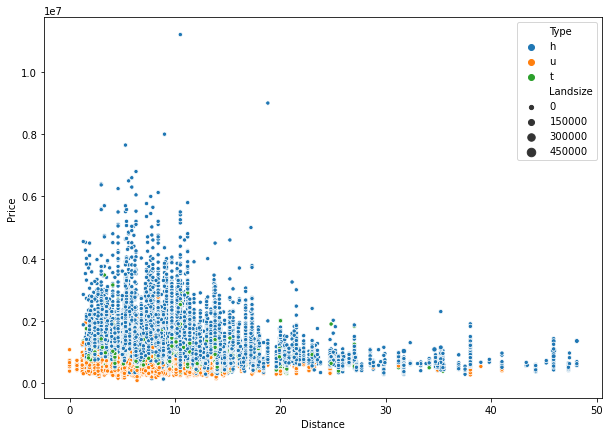

In [52]:
plt.figure(figsize=(10,7))
sns.scatterplot(mel['Distance'],mel['Price'],mel['Type'],size=mel['Landsize'])

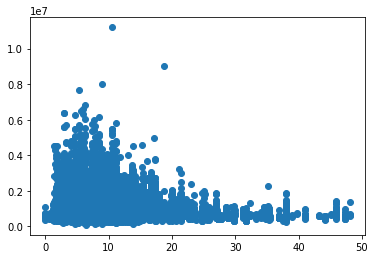

In [57]:
import statsmodels.api as sm
y=mel['Price']
x1=mel['Distance']
plt.scatter(x1,y)

In [59]:
x=sm.add_constant(x1)
result=sm.OLS(y,x).fit()
result.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  Price   R-squared:                       0.055
Model:                            OLS   Adj. R-squared:                  0.055
Method:                 Least Squares   F-statistic:                     1231.
Date:                Thu, 06 Aug 2020   Prob (F-statistic):          3.42e-262
Time:                        16:13:55   Log-Likelihood:            -3.1027e+05
No. Observations:               20993   AIC:                         6.205e+05
Df Residuals:                   20991   BIC:                         6.206e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       1.343e+06   8445.421    159.035      0.000    1.33e+06    1.36e+06
Distance   -2.231e+04    635.665    -35.091      0.000   -2.36e+04   -2.11e+04
==============================================================================
Omnibus:                    11852.754   Durbin-Watson:                   1.434
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           170543.494
Skew:                           2.423   Prob(JB):                         0.00
Kurtosis:                      16.095   Cond. No.                         25.7
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

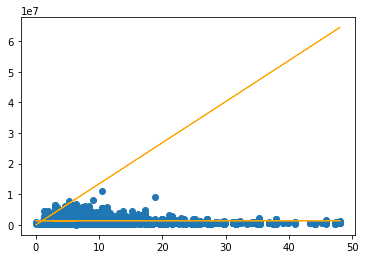

In [61]:
plt.scatter(x1,y)
yhat=1.343e+06*x+-2.231e+04
fig = plt.plot(x1,yhat, lw=1, c='orange', label ='regression line')
plt.show()

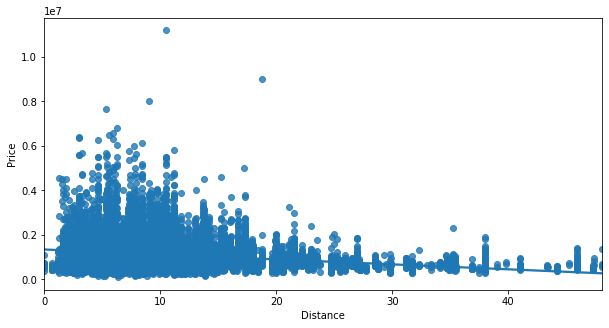

In [25]:
plt.figure(figsize=(10,5))
sns.regplot(x=mel['Distance'],y=mel['Price'])

In [26]:
mel['discat']=pd.cut(mel['Distance'],bins=3,labels='near medium far'.split())
mel[['Distance','discat']]

,Distance,discat
1,2.5,near
2,2.5,near
4,2.5,near
5,2.5,near
6,2.5,near
...,...,...
34851,6.3,near
34852,6.3,near
34853,6.3,near
34854,6.3,near


In [27]:
mel_byDist=mel.groupby('discat')

In [28]:
mel_byDist.mean()

,Rooms,Price,Distance,Postcode,Bedroom2,Bathroom,Car,Landsize,YearBuilt,Lattitude,Longtitude,Propertycount,ys,ms
discat,,,,,,,,,,,,,,
near,2.973154,1.151632e+06,8.859015,3093.445260,2.956150,1.544840,1.658106,467.773934,1961.322211,-37.806440,144.984741,7435.895528,2016.725600,7.121477
medium,3.444380,8.223396e+05,21.034467,3182.382709,3.448415,1.765130,2.004899,531.957925,1975.018156,-37.788605,145.040560,7704.004035,2017.236023,7.187320
far,3.458689,7.057119e+05,38.015100,3481.304843,3.450142,1.783476,2.128205,2237.091168,1973.638177,-38.014020,145.148828,9621.287749,2017.207977,7.296296


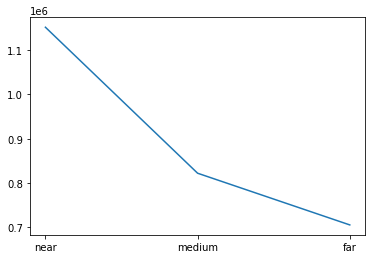

In [29]:
plt.plot(list(mel_byDist.groups.keys()),mel_byDist.mean()['Price'])

([<matplotlib.patches.Wedge at 0x1f4041b9160>,
 [Text(-1.0733303268513836, 0.24075300509256792, 'near'),
  Text(0.5492247144670235, -0.9530751350332337, 'medium'),
  Text(0.8097607900399784, 0.744504844117102, 'far')],
 [Text(-0.5854529055553002, 0.13131982095958247, '43.0'),
  Text(0.2995771169820128, -0.5198591645635819, '30.7'),
  Text(0.44168770365816995, 0.4060935513366011, '26.3')])

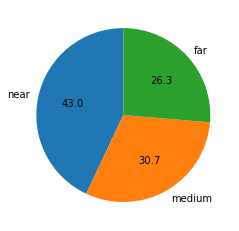

In [30]:
plt.pie(mel_byDist.mean()['Price']/3*100,labels=list(mel_byDist.groups.keys()),autopct='%.1f',startangle=90)

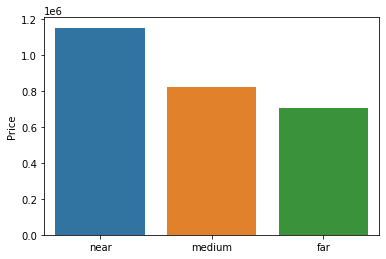

In [31]:
sns.barplot(list(mel_byDist.groups.keys()),mel_byDist.mean()['Price'])

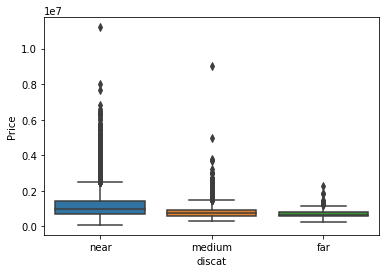

In [32]:
sns.boxplot(mel['discat'],mel['Price'])